In [1]:
%matplotlib inline

import glob 
import itertools
import os 
import re
from itertools import izip

from IPython.core.display import HTML
from matplotlib import gridspec
import numpy as np

import pandas as pd
import scipy
import seaborn as sns
from matplotlib_venn import venn2, venn3

from gscripts import GO
from gscripts.general import region_helpers
from gscripts.general import dataviz
from gscripts.general import parsers
from gscripts.rnaseq import helpers

img_dir = "/nas3/gpratt/Dropbox/TAF15/Data/MN_data/GP_analysis_RNAseq/"

In [2]:
gene_id_to_name = region_helpers.gene_id_to_name("/nas3/gpratt/gencode/gencode.v17.annotation.gtf.db")
name_to_gene_id = {value: key for key, value in gene_id_to_name.items()}



def gencode_to_ensembl(gene_list):
    for gene in gene_list:
        yield gene.split(".")[0]
        
def plot_go_enrichment(df, filter_value=None, **kwargs):
    
    new_index = []
    for index, description in izip(df.index, df['GO Term Description']):
        new_index.append(list(index[:-1]) + [description])
    df.index = pd.MultiIndex.from_tuples(new_index)

    go_matrix = df['Bonferroni-corrected Hypergeometric p-Value'].apply(lambda x: -1 * np.log10(x))
    go_matrix = go_matrix.unstack(range(len(go_matrix.index.levels) - 1))
    go_matrix = go_matrix.fillna(0)
    if filter_value is not None:
        go_matrix = go_matrix[go_matrix.apply(max, axis=1) > filter_value]
        
    sns.clustermap(go_matrix, robust=True, **kwargs)

In [3]:
!mkdir -p /nas3/gpratt/projects/fet_family/analysis/av_mn_v2
!scp -q tscc-login.sdsc.edu:~/projects/fet_family/analysis/av_mn_v2/*.{metrics,final.out,txt} /nas3/gpratt/projects/fet_family/analysis/av_mn_v2/

In [44]:
filtered_guttman_clip["Uniquely Mapped Reads"].mean()

5232086.2352941176

In [10]:
analysis_dir = "/nas3/gpratt/projects/fet_family/analysis/av_mn_v2/"
fet_clip = parsers.rnaseq_metrics(analysis_dir)

fet_clip["Reads After Triming"] = fet_clip['Input Reads'] - fet_clip['Too short reads']

filtered_guttman_clip = fet_clip[[ "Input Reads",
                            "Reads After Triming",
                            "Uniquely Mapped Reads",
                            "Uniquely mapped reads %",
                            ]]

HTML(filtered_guttman_clip.to_html(formatters={"Input Reads" : parsers.commas,
                                     "Reads After Triming" : parsers.commas,
                                     "Reads after Quality Filtering" : parsers.commas,
                                     "Uniquely Mapped Reads" : parsers.commas,
                                     "Usable Reads" : parsers.commas,
                                     "Num Peaks": parsers.commas
                                     } ))

,Input Reads,Reads After Triming,Uniquely Mapped Reads,Uniquely mapped reads %
AV_47d_1_TAATGCG_L005_R1,"42,909,648","42,826,901","37,734,635",90.75%
AV_47d_puro_1_CGGCTAT_L005_R1,"41,949,026","41,873,081","37,775,740",92.69%
AV_AGB025_1_CGCTCAT_L001_R1,"13,251,659","13,228,828","11,473,573",91.75%
AV_AGB025_puro_1_GAGATTC_L001_R1,"17,645,544","17,615,957","15,506,409",91.72%
AV_ALS17_1_1_TCTCGCG_L002_R1,"18,794,718","18,741,065","16,213,381",91.81%
AV_ALS17_1_puro_1_CGCTCAT_L002_R1,"11,485,900","11,460,164","10,094,548",91.57%
AV_ALS17_5_1_GAGATTC_L002_R1,"9,864,097","9,846,355","8,598,988",91.40%
AV_ALS17_5_puro_1_ATTCAGA_L002_R1,"5,878,809","5,867,814","5,264,204",92.64%
AV_ALS6_2_1_ATTACTC_L003_R1,"15,610,803","15,588,506","13,612,334",90.67%
AV_ALS6_2_puro_1_TCCGGAG_L003_R1,"14,957,642","14,936,657","13,212,696",91.49%


In [5]:
counts = pd.read_table("/nas3/gpratt/Dropbox/TAF15/Data/anthony_rnaseq/all_counts.txt", skiprows=1, index_col=0)
counts.columns = [re.sub("_L[0-9]*", "", os.path.basename(item).split(".")[0].replace("_R1", "")) for item in  counts.columns]
rpkm = helpers.counts_to_rpkm(counts).T

In [6]:
metadata = pd.read_csv("/nas3/gpratt/Dropbox/TAF15/Data/anthony_rnaseq/sample_metadata_temp.csv", header=None)
metadata = [line.values[0].split("\t") for name, line in metadata.iterrows()]
metadata = pd.DataFrame(metadata[1:], columns=metadata[0])
metadata.bad_sample = metadata.bad_sample.apply(int)
metadata.stressed = metadata.stressed.apply(int)
metadata.virus = metadata.virus.apply(int)
metadata.filename = metadata.filename.apply(lambda x: re.sub("_L[0-9]*", "", x))
metadata.index = metadata.filename

Keep AV_KIN1ALS6_4_shSCR_1_CTGAAGC, but remove the rest of the virus samples

In [7]:
filtered_metadata = metadata[(metadata.bad_sample == 0) & (metadata.stressed == 0)]
filtered_metadata['useful_control'] = filtered_metadata.filename.isin(["AV_KIN1ALS6_4_1_TCCGCGA", 
                                                                       "AV_KIN1ALS17_3_1_TAATGCG", 
                                                                       "AV_KIN1ALS6_4_shSCR_1_CTGAAGC"])

/nas/nas0/gpratt/anaconda/lib/python2.7/site-packages/IPython/kernel/__main__.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


In [13]:
filtered_guttman_clip.index = [re.sub("_L[0-9]*", "", os.path.basename(item).split(".")[0].replace("_R1", "")) for item in  filtered_guttman_clip.index]

filtered_guttman_clip = filtered_guttman_clip.join(metadata)
only_reported_mn_data = filtered_guttman_clip[(filtered_guttman_clip.bad_sample == 0) & \
                                              (filtered_guttman_clip.stressed == 0) & \
                                              (filtered_guttman_clip.virus == 0) \
                                             ]  
only_reported_mn_data = only_reported_mn_data[(only_reported_mn_data['type'] == "CONTROL") | (only_reported_mn_data.mutation == 'R521G')] 

In [16]:
only_reported_mn_data['Uniquely Mapped Reads'].mean()

19883784.399999999

In [17]:
np.mean([float(item[:-1]) for item in only_reported_mn_data['Uniquely mapped reads %']])

90.109999999999999

In [7]:
result = []
for name, items in metadata.iterrows():
    result.append(items.values)
rpkm.index = pd.MultiIndex.from_tuples(result, names=items.index)

In [8]:
filtered_rpkm = rpkm[(rpkm.index.get_level_values(level="bad_sample") == 0) & 
                     (rpkm.index.get_level_values(level="stressed") == 0) #  &
                     #(rpkm.index.get_level_values(level="mutation") != "N352S")
                     ]

n352s_rpkm = rpkm[(rpkm.index.get_level_values(level="bad_sample") == 0) & 
                     (rpkm.index.get_level_values(level="stressed") == 0)   &
                     (rpkm.index.get_level_values(level="mutation") == "N352S")]

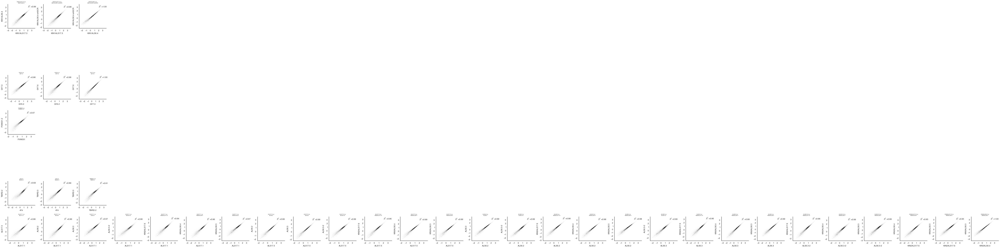

In [9]:
max_combinations = np.max(filtered_rpkm.groupby(level=['type', 'mutation']).count().values)
num_rows = len(list(filtered_rpkm.groupby(level=['type', 'mutation'])))
num_cols = len(list(itertools.combinations(range(max_combinations), 2)))

with dataviz.Figure(os.path.join(img_dir, "replicate_plotting.svg"), figsize=(2.5 * num_cols,2.5 * num_rows)) as fig:
    gs = gridspec.GridSpec(num_rows, num_cols)
    for x, (name, group) in enumerate(filtered_rpkm.groupby(level=['type', 'mutation'])):
        for y, (name1, name2) in enumerate(itertools.combinations(group.index, 2)):
            ax = fig.add_subplot(gs[x,y]) 
            series1 = filtered_rpkm.ix[name1]
            series2 = filtered_rpkm.ix[name2]

            dataviz.loglog_hist2d(series1, series2, ax=ax)
            sns.despine(ax=ax)
            name1 = name1[1]
            name2 = name2[1]

            ax.set_xlabel(name1, fontsize=10)
            ax.set_ylabel(name2, fontsize=10)            
            r2 = scipy.stats.linregress(series1, series2)[2]
            ax.text(2, 3, "$R^2$={:.2f}".format(r2))
            ax.set_title("{} vs\n{}".format(name1, name2), fontsize=6)
            [tick.set_fontsize(10) for tick in ax.get_xticklabels()]
            [tick.set_fontsize(10) for tick in ax.get_yticklabels()]


In [10]:
counts[filtered_metadata.filename.values].T.to_csv("/nas3/gpratt/Dropbox/TAF15/Data/anthony_rnaseq/important_counts.csv")
filtered_metadata.to_csv("/nas3/gpratt/Dropbox/TAF15/Data/anthony_rnaseq/metadata.csv")

In [76]:
filtered_guttman_clip.ix[filtered_metadata[filtered_metadata.mutation == 'R521G'].filename]

,Input Reads,Reads After Triming,Uniquely Mapped Reads,Uniquely mapped reads %,filename,sample_name,bad_sample,stressed,virus,type,mutation
AV_GY6_2_1_CTGAAGC,11700261,11682824,172516,1.48%,AV_GY6_2_1_CTGAAGC,GY6.2,0,0,0,FUS,R521G
AV_GY7_3_1_CGGCTAT,20679998,20638904,346961,1.68%,AV_GY7_3_1_CGGCTAT,GY7.3,0,0,0,FUS,R521G
AV_GY7_6_1_TCCGGAG,30072605,30028669,26347527,90.51%,AV_GY7_6_1_TCCGGAG,GY7.6,0,0,0,FUS,R521G


In [72]:
counts[filtered_metadata.filename.values].T

Geneid,ENSG00000223972.4,ENSG00000227232.4,ENSG00000243485.1,ENSG00000237613.2,ENSG00000268020.1,ENSG00000240361.1,ENSG00000186092.4,ENSG00000238009.2,ENSG00000239945.1,ENSG00000233750.3,...,ENSG00000198886.2,ENSG00000210176.1,ENSG00000210184.1,ENSG00000210191.1,ENSG00000198786.2,ENSG00000198695.2,ENSG00000210194.1,ENSG00000198727.2,ENSG00000210195.2,ENSG00000210196.2
AV_47d_1_TAATGCG,52,3785,55,1,0,0,0,75,0,5,...,210084,5,3,0,111882,2922,9,93826,157,19
AV_ALS17_1_1_TCTCGCG,21,2022,26,0,0,0,0,37,0,1,...,77514,2,2,0,41388,416,3,36062,36,12
AV_ALS17_5_1_GAGATTC,22,1109,24,0,0,0,0,18,0,0,...,39319,1,2,1,23018,577,3,17144,33,2
AV_ALS6_2_1_ATTACTC,21,1399,32,0,0,0,0,28,0,0,...,58749,1,2,0,27459,902,7,25711,71,4
AV_ALS6_3_1_CGCTCAT,15,1906,44,0,0,0,0,31,0,1,...,89463,0,2,0,43992,1161,3,41241,83,9
AV_ALS6_3_2_1_ATTCAGA,17,867,30,0,0,0,0,28,0,0,...,68762,3,3,0,33949,570,3,27621,91,5
AV_FVW031_1_ATTACTC,8,1036,13,0,0,0,0,10,0,1,...,35985,3,0,0,19224,371,0,14711,23,0
AV_FVW031_2_1_TCTCGCG,83,4216,154,1,0,0,0,78,0,1,...,221465,2,0,0,113950,826,5,77818,190,11
AV_GY6_2_1_CTGAAGC,34,1639,90,0,0,0,0,23,0,1,...,51139,2,1,0,29377,640,1,17169,63,1
AV_GY7_3_1_CGGCTAT,34,2336,119,1,0,0,0,45,0,1,...,95507,1,2,1,41412,1214,1,41387,100,8


In [11]:
knockdowns = pd.concat({os.path.basename(rbp).split(".")[0]: pd.read_csv(rbp, index_col=0) for rbp in glob.glob("/nas3/gpratt/Dropbox/TAF15/Data/anthony_rnaseq/deseq/*")})
knockdowns['gene_names'] = [gene_id_to_name[gene_id] for gene_id in knockdowns.index.get_level_values(level=1)]

results = []
cashe = {}
for item in knockdowns.index:
    gene_id = item[1]
    mutation = item[0].upper()
    if mutation not in cashe:
        cashe[mutation] = list(set(filtered_metadata[filtered_metadata.mutation  == item[0].upper()].type))[0]

    rbp = cashe[mutation]
    
    results.append([rbp, mutation, gene_id])
    
knockdowns.index = pd.MultiIndex.from_tuples(results, names=["rbp", 'mutation', "gene"])
knockdowns = knockdowns.sortlevel()

In [12]:
significant_knockdowns = knockdowns[(knockdowns.padj <= .05) & (abs(knockdowns.log2FoldChange) > 1)]
signifcant_upregulated = significant_knockdowns[significant_knockdowns.log2FoldChange > 0]
signifcant_downregulated = significant_knockdowns[significant_knockdowns.log2FoldChange < 0]

In [13]:
significant_knockdowns.groupby(level=["rbp", 'mutation']).count().padj 

rbp  mutation
FUS  R521G       1169
     T198C        529
TDP  G298S        271
     N352S        472
Name: padj, dtype: int64

In [14]:
signifcant_upregulated.groupby(level=["rbp", 'mutation']).count().padj 

rbp  mutation
FUS  R521G       575
     T198C       234
TDP  G298S       202
     N352S       277
Name: padj, dtype: int64

In [15]:
HTML(signifcant_upregulated.to_html())

In [16]:
signifcant_downregulated.groupby(level=["rbp", 'mutation']).count().padj 

rbp  mutation
FUS  R521G       594
     T198C       295
TDP  G298S        69
     N352S       195
Name: padj, dtype: int64

In [17]:
HTML(signifcant_downregulated.to_html())

/nas3/gpratt/anaconda/lib/python2.7/site-packages/pandas/core/index.py:1353: FutureWarning: using '-' to provide set differences with Indexes is deprecated, use .difference()
  "use .difference()",FutureWarning)


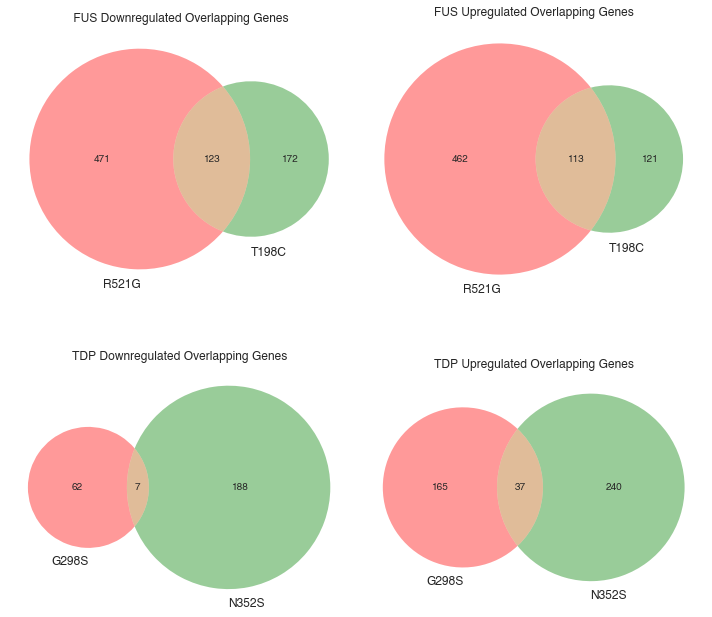

In [18]:
count = 0
with dataviz.Figure(os.path.join(img_dir, "up_and_down_regulation_overlap_taf15_tdp43.svg"), figsize=(10, 10)) as fig:
        count += 1
        ax = fig.add_subplot(2,2,count)
        venn2([signifcant_downregulated.ix['FUS', 'R521G'].index.get_level_values(level='gene'),
               signifcant_downregulated.ix['FUS', 'T198C'].index.get_level_values(level='gene'),
        ],
                set_labels=("R521G", "T198C"), ax =ax )
        ax.set_title(" FUS Downregulated Overlapping Genes")

        count +=1
        ax = fig.add_subplot(2,2,count)
        venn2([signifcant_upregulated.ix['FUS', 'R521G'].index.get_level_values(level='gene'),
        signifcant_upregulated.ix['FUS', 'T198C'].index.get_level_values(level='gene'),
        ],
                set_labels=("R521G", "T198C"), ax =ax )
        ax.set_title("FUS Upregulated Overlapping Genes")
        
        count += 1
        ax = fig.add_subplot(2,2,count)
        venn2([signifcant_downregulated.ix['TDP', 'G298S'].index.get_level_values(level='gene'),
               signifcant_downregulated.ix['TDP', 'N352S'].index.get_level_values(level='gene'),
        ],
                set_labels=("G298S", "N352S"), ax =ax )
        ax.set_title("TDP Downregulated Overlapping Genes")

        count +=1
        ax = fig.add_subplot(2,2,count)
        venn2([signifcant_upregulated.ix['TDP', 'G298S'].index.get_level_values(level='gene'),
                signifcant_upregulated.ix['TDP', 'N352S'].index.get_level_values(level='gene'),
        ],
                set_labels=("G298S", "N352S"), ax =ax )
        ax.set_title("TDP Upregulated Overlapping Genes")

In [19]:
hg19go = GO.hg19GO()

In [20]:
#This takes a few minutes...
downregulated_go = {}
for name, df in signifcant_downregulated.groupby(level=["rbp", "mutation"]):
    cell_type = name[0]
    downregulated_go[name] = hg19go.enrichment(gencode_to_ensembl(df.index.get_level_values(level="gene")),
                                               #background=expressed_genes[cell_type]
                                               )
    
downregulated_go = pd.concat(downregulated_go, names=['rbp', 'mutation', 'go_term_id'])

upregulated_go = {}
for name, df in signifcant_upregulated.groupby(level=["rbp", "mutation"]):
    cell_type = name[0]
    upregulated_go[name] = hg19go.enrichment(gencode_to_ensembl(df.index.get_level_values(level="gene")),
                                             #background=expressed_genes[cell_type]
                                             )
    
upregulated_go = pd.concat(upregulated_go,  names=['rbp', 'mutation', 'go_term_id'])

#Down Regulated GO Terms

In [21]:
HTML(downregulated_go.to_html())

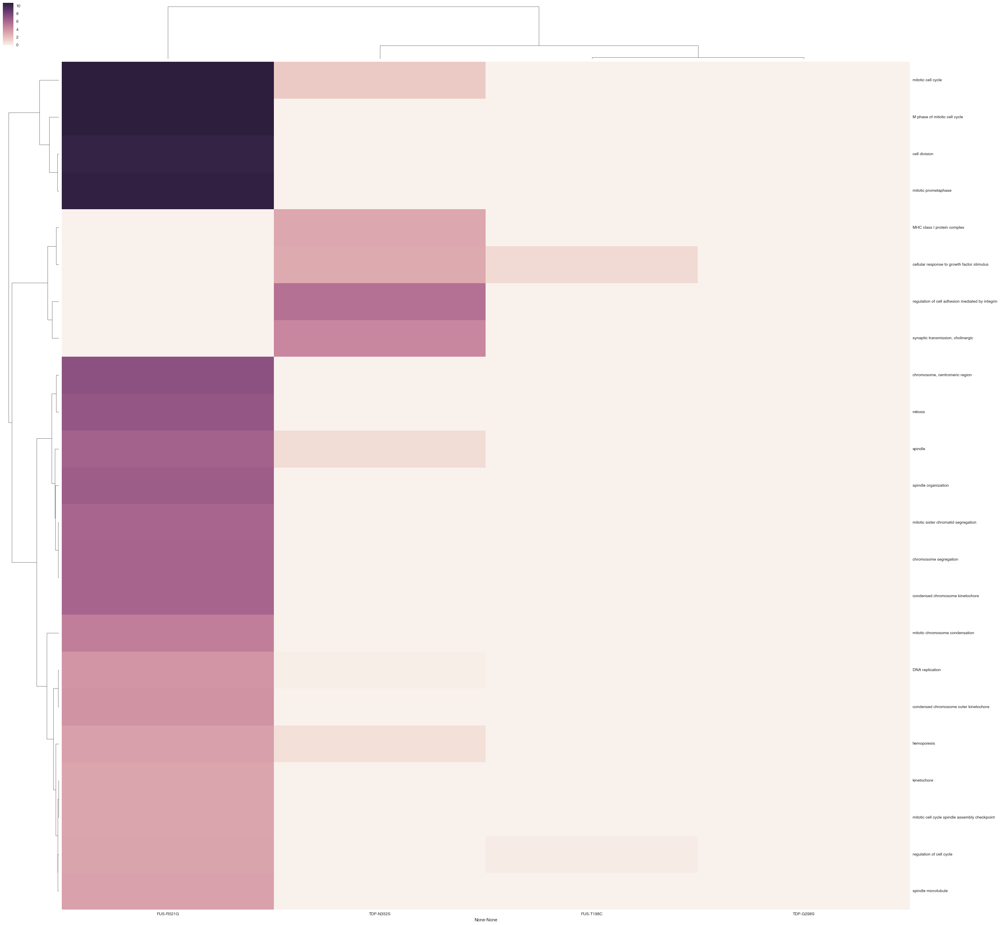

In [22]:
plot_go_enrichment(downregulated_go, filter_value=3, figsize=(40,40))

#Upregulated GO Terms

In [23]:
HTML(upregulated_go.to_html())

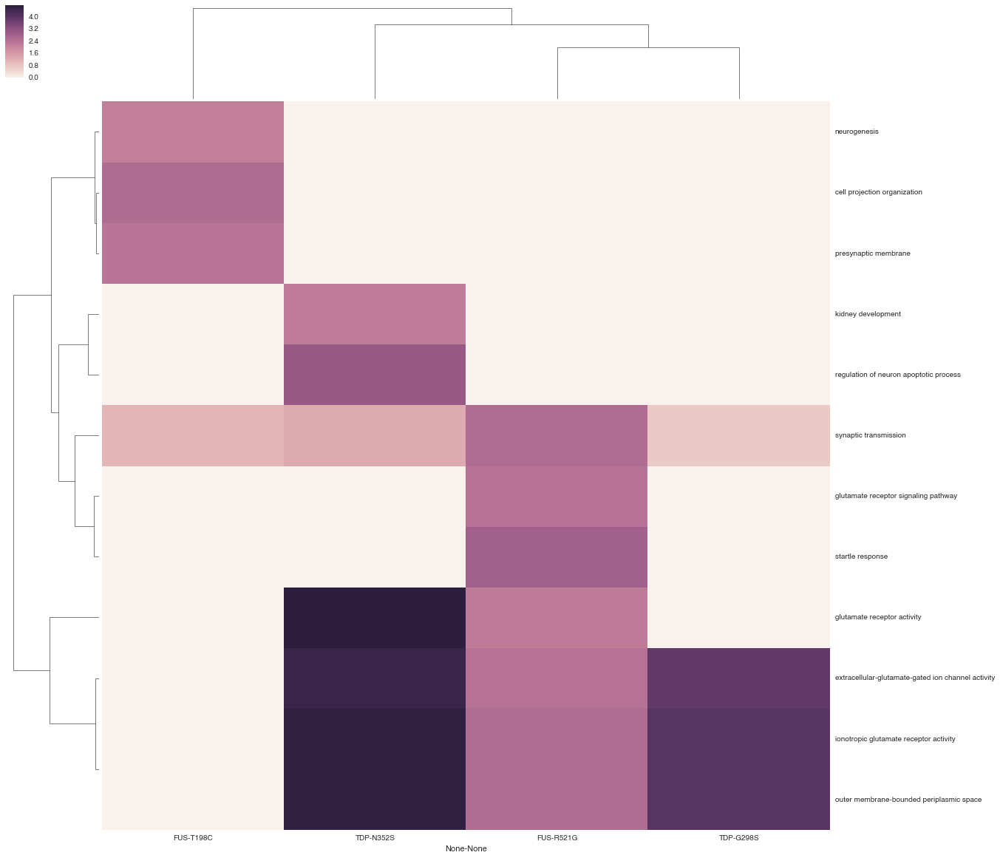

In [24]:
plot_go_enrichment(upregulated_go, filter_value=2, figsize=(20,20))

#Checking Mitochondira Related Genes

In [25]:
ensembl_rpkm = rpkm.copy()
ensembl_rpkm.columns = [item.split('.')[0] for item in ensembl_rpkm.columns] 

In [26]:
mt_sig_gene_ids = """ENSG00000145113,ENSG00000176945,ENSG00000117983,ENSG00000198788,ENSG00000184956,ENSG00000205277,ENSG00000198727,ENSG00000198786,ENSG00000212907,ENSG00000228253,ENSG00000198763,ENSG00000198886,ENSG00000198695,ENSG00000198888,ENSG00000198899,ENSG00000198786,ENSG00000212907,ENSG00000198763,ENSG00000198886,ENSG00000198695,ENSG00000198888,ENSG00000212907,ENSG00000198886,ENSG00000198763,ENSG00000198786""".split(",")

In [27]:
ensembl_target_ids = [item.split(".")[0] for item in knockdowns.index.get_level_values("gene")]

In [28]:
knockdowns.ix[[gene in mt_sig_gene_ids for gene in ensembl_target_ids]]

baseMean  log2FoldChange     lfcSE  \
rbp mutation gene                                                          
FUS R521G    ENSG00000117983.13       0.162723        0.151529  0.330855   
             ENSG00000145113.17      45.461223        1.466761  0.603750   
             ENSG00000176945.12     222.149541        0.557580  0.233427   
             ENSG00000184956.11       0.279833        0.236858  0.403251   
             ENSG00000198695.2     1054.658849        0.597899  0.212787   
             ENSG00000198727.2    41562.427335       -0.392339  0.185497   
             ENSG00000198763.3    48176.472323       -0.126737  0.165702   
             ENSG00000198786.2    43245.382857        0.028444  0.156048   
             ENSG00000198788.7        3.091359       -0.895684  0.758466   
             ENSG00000198886.2    97408.347851       -0.315252  0.137874   
             ENSG00000198888.2    32657.294278       -0.204671  0.259034   
             ENSG00000198899.2    47114.556816       -0.342557  0.227095   
             ENSG00000205277.5       55.458287        0.212208  0.569645   
             ENSG00000212907.2     9542.626392       -0.138439  0.159592   
             ENSG00000228253.1     3827.551823       -0.293150  0.265334   
    T198C    ENSG00000117983.13       0.185598        0.148732  0.294955   
             ENSG00000145113.17      32.917956        0.934442  0.713329   
             ENSG00000176945.12     188.522230        0.210528  0.309629   
             ENSG00000184956.11       0.000000             NaN       NaN   
             ENSG00000198695.2      752.872784       -0.339567  0.378220   
             ENSG00000198727.2    42398.602001       -0.366445  0.185425   
             ENSG00000198763.3    43785.475454       -0.492232  0.241096   
             ENSG00000198786.2    45323.826728        0.237867  0.181955   
             ENSG00000198788.7        3.681168       -0.452770  0.755150   
             ENSG00000198886.2   102147.821150       -0.159133  0.178448   
             ENSG00000198888.2    30716.321528       -0.450245  0.331682   
             ENSG00000198899.2    46487.330578       -0.444523  0.222506   
             ENSG00000205277.5       47.659339       -0.153778  0.595392   
             ENSG00000212907.2     9633.380213       -0.089252  0.196970   
             ENSG00000228253.1     3697.971119       -0.458515  0.348212   
TDP G298S    ENSG00000117983.13       0.170906        0.129347  0.276423   
             ENSG00000145113.17      18.231219       -0.378363  0.624771   
             ENSG00000176945.12     156.660187       -0.692199  0.311676   
             ENSG00000184956.11       0.000000             NaN       NaN   
             ENSG00000198695.2      821.369867       -0.255180  0.481997   
             ENSG00000198727.2    40512.737364       -0.724985  0.371672   
             ENSG00000198763.3    48607.848341       -0.305997  0.485356   
             ENSG00000198786.2    45389.207112       -0.064601  0.366245   
             ENSG00000198788.7        5.377713       -0.059051  0.676209   
             ENSG00000198886.2   100124.869017       -0.473117  0.318235   
             ENSG00000198888.2    29488.721487       -0.764608  0.434155   
             ENSG00000198899.2    45751.574263       -0.656500  0.445790   
             ENSG00000205277.5      156.102776        1.865877  0.505285   
             ENSG00000212907.2     8904.566803       -0.604997  0.329630   
             ENSG00000228253.1     3372.535521       -0.957966  0.445920   
    N352S    ENSG00000117983.13       0.252803        0.392245  0.492732   
             ENSG00000145113.17      26.864893        0.555434  0.573165   
             ENSG00000176945.12     215.605437        0.549677  0.204964   
             ENSG00000184956.11       0.274952        0.405331  0.498279   
             ENSG00000198695.2      895.307211        0.333789  0.252691   
             ENSG00000198727.2    37402.269577       -0.244116  0.178460   
          

In [29]:
ensembl_rpkm[mt_sig_gene_ids]

,,,,,,,ENSG00000145113,ENSG00000176945,ENSG00000117983,ENSG00000198788,ENSG00000184956,ENSG00000205277,ENSG00000198727,ENSG00000198786,ENSG00000212907,ENSG00000228253,...,ENSG00000198786,ENSG00000212907,ENSG00000198763,ENSG00000198886,ENSG00000198695,ENSG00000198888,ENSG00000212907,ENSG00000198886,ENSG00000198763,ENSG00000198786
filename,sample_name,bad_sample,stressed,virus,type,mutation,,,,,,,,,,,,,,,,,,,,,
AV_47d_1_TAATGCG,47d,0,0,0,TDP,G298S,0.044686,0.599073,0.002845,0.012180,0.000000,0.618109,2176.707177,1634.423054,1472.723405,918.028279,...,1634.423054,1472.723405,4528.872039,4035.582332,147.327344,1929.163651,1472.723405,4035.582332,4528.872039,1634.423054
AV_47d_puro_1_CGGCTAT,47d-puro,0,1,0,TDP,G298S,0.228506,2.821270,0.016090,0.012526,0.000000,2.870085,1370.688422,628.184897,710.178497,545.510052,...,628.184897,710.178497,3005.413163,1747.401867,64.557158,1782.103164,710.178497,1747.401867,3005.413163,628.184897
AV_AGB025_1_CGCTCAT,AGB025,1,0,0,FUS,,0.154613,2.140717,0.000000,0.000000,0.000000,0.261981,1853.401299,1381.125525,1837.896222,999.486793,...,1381.125525,1837.896222,2136.811828,3636.872246,83.387272,1296.867812,1837.896222,3636.872246,2136.811828,1381.125525
AV_AGB025_puro_1_GAGATTC,AGB025-puro,1,1,0,FUS,,1.462409,7.436145,0.003888,0.149825,0.008585,6.868213,1690.528514,760.587125,1461.270421,1306.970247,...,760.587125,1461.270421,4085.948677,2364.309765,82.555897,2462.106033,1461.270421,2364.309765,4085.948677,760.587125
AV_ALS17_1_1_TCTCGCG,ALS17.1,0,0,0,TDP,N352S,0.030862,2.344046,0.003536,0.007571,0.000000,0.218990,2080.038929,1503.223462,1819.035207,598.351759,...,1503.223462,1819.035207,2525.122021,3702.015472,52.148441,1721.171543,1819.035207,3702.015472,2525.122021,1503.223462
AV_ALS17_1_puro_1_CGCTCAT,ALS17.1-puro,1,1,0,TDP,N352S,0.791004,4.491080,0.000000,0.024719,0.000000,7.168968,1126.382641,497.890403,871.823133,768.173224,...,497.890403,871.823133,2450.714469,1421.831596,90.454622,1591.714446,871.823133,1421.831596,2450.714469,497.890403
AV_ALS17_5_1_GAGATTC,ALS17.5,0,0,0,TDP,N352S,0.119147,2.274382,0.000000,0.027836,0.000000,0.204830,1817.942468,1536.961589,1819.755852,1450.140361,...,1536.961589,1819.755852,2425.977155,3452.286801,132.975040,1751.460868,1819.755852,3452.286801,2425.977155,1536.961589
AV_ALS17_5_puro_1_ATTCAGA,ALS17.5-puro,0,1,0,TDP,N352S,0.663897,4.789169,0.000000,0.143702,0.000000,2.199896,945.567981,476.723142,760.596429,972.606398,...,476.723142,760.596429,2435.062349,1197.226284,111.833212,1302.775282,760.596429,1197.226284,2435.062349,476.723142
AV_ALS6_2_1_ATTACTC,ALS6.2,0,0,0,TDP,N352S,0.062807,1.297508,0.000000,0.008560,0.008829,0.130313,1676.710551,1127.590211,1535.027656,844.738504,...,1127.590211,1535.027656,2367.801991,3172.313025,127.841544,1519.388876,1535.027656,3172.313025,2367.801991,1127.590211


#Give Anthony Data for Tempo-Seq

In [30]:
df = pd.read_table("/nas3/gpratt/Dropbox/TAF15/Data/anthony_rnaseq/gene_list.csv", header=None, names=["gene_name"])

In [31]:
df['gene_id'] = df[df.gene_name.isin(name_to_gene_id)].gene_name.apply(lambda x: name_to_gene_id[x])
df = df.dropna()

In [32]:
counts.ix[df.gene_id][['AV_KIN1ALS6_4_1_TCCGCGA', 'AV_ALS6_3_1_CGCTCAT']].to_csv("/nas3/gpratt/Dropbox/TAF15/Data/anthony_rnaseq/tempo_seq_counts.txt")
rpkm[df.gene_id].ix[['AV_KIN1ALS6_4_1_TCCGCGA', 'AV_ALS6_3_1_CGCTCAT']].to_csv("/nas3/gpratt/Dropbox/TAF15/Data/anthony_rnaseq/tempo_seq_rpkm.txt")

#Look at differental LIF expression

In [33]:
lif_only = filtered_rpkm[name_to_gene_id['LIF']].copy()

In [34]:
lif_only

filename                       sample_name       bad_sample  stressed  virus  type     mutation
AV_47d_1_TAATGCG               47d               0           0         0      TDP      G298S       0.086701
AV_ALS17_1_1_TCTCGCG           ALS17.1           0           0         0      TDP      N352S       0.132653
AV_ALS17_5_1_GAGATTC           ALS17.5           0           0         0      TDP      N352S       0.060968
AV_ALS6_2_1_ATTACTC            ALS6.2            0           0         0      TDP      N352S       0.074990
AV_ALS6_3_1_CGCTCAT            ALS6.3            0           0         0      TDP      N352S       0.029628
AV_ALS6_3_2_1_ATTCAGA          ALS6.3-2          0           0         0      TDP      N352S       0.020779
AV_FVW031_1_ATTACTC            FVW031            0           0         0      FUS      T198C       0.036998
AV_FVW031_2_1_TCTCGCG          FVW031-2          0           0         0      FUS      T198C       0.403145
AV_GY6_2_1_CTGAAGC             GY6.2    

In [35]:
lif_only.index = lif_only.index.droplevel(["filename", "sample_name", "bad_sample", "stressed", "virus"])
lif_only.index = ["_".join(item) for item in lif_only.index]
story_only = lif_only[['CONTROL_', 'FUS_R521G']]

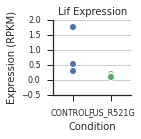

In [38]:
num_rows = 1
num_cols = 1
with sns.axes_style("ticks", {'axes.grid': True}):

    with dataviz.Figure(os.path.join(img_dir, "lif_ips_mv_data.svg"), figsize=(2.0 * num_cols, 2.0 * num_cols)) as fig:
        ax = fig.add_subplot(num_rows,num_cols,1)
        ax = sns.stripplot(story_only.index, 
                    story_only)
        ax.set_ylabel("Expression (RPKM)", fontsize=10)
        ax.set_title("Lif Expression", fontsize=10)
        ax.set_xlabel("Condition", fontsize=10)
        sns.despine(ax=ax)
        [tick.set_fontsize(8) for tick in ax.get_xticklabels()]
        [tick.set_fontsize(8) for tick in ax.get_yticklabels()]

In [42]:
stat3_only = filtered_rpkm[name_to_gene_id['STAT3']].copy()
stat3_only.index = stat3_only.index.droplevel(["filename", "sample_name", "bad_sample", "stressed", "virus"])
stat3_only.index = ["_".join(item) for item in stat3_only.index]
story_only = lif_only[['CONTROL_', 'FUS_R521G']]

KeyError: 'cannot index a multi-index axis with these keys'

In [ ]:
num_rows = 1
num_cols = 1
with sns.axes_style("ticks", {'axes.grid': True}):

    with dataviz.Figure(os.path.join(img_dir, "lif_ips_mv_data.svg"), figsize=(2.0 * num_cols, 2.0 * num_cols)) as fig:
        ax = fig.add_subplot(num_rows,num_cols,1)
        ax = sns.stripplot(story_only.index, 
                    story_only)
        ax.set_ylabel("Expression (RPKM)", fontsize=10)
        ax.set_title("Lif Expression", fontsize=10)
        ax.set_xlabel("Condition", fontsize=10)
        sns.despine(ax=ax)
        [tick.set_fontsize(8) for tick in ax.get_xticklabels()]
        [tick.set_fontsize(8) for tick in ax.get_yticklabels()]